Welcome. This notebook can be used to try out the Stable Image Services. This implementation can be used in your production environment if you are developing an application using the API.

New to colab? Just hit the play button on each of the cells and follow instructions.

You will need an account on https://platform.stability.ai/ to use the features.

Have fun and do great things.

In [1]:
#@title Install requirements
from io import BytesIO
import IPython
import json
import os
from PIL import Image
import requests
import time
from google.colab import output

In [2]:
#@title Connect to the Stability API

import getpass
# @markdown To get your API key visit https://platform.stability.ai/account/keys
STABILITY_KEY = getpass.getpass('Enter your API Key')



Enter your API Key··········


In [3]:
#@title Define functions

def send_generation_request(
    host,
    params,
):
    headers = {
        "Accept": "image/*",
        "Authorization": f"Bearer {STABILITY_KEY}"
    }

    # Encode parameters
    files = {}
    image = params.pop("image", None)
    mask = params.pop("mask", None)
    if image is not None and image != '':
        files["image"] = open(image, 'rb')
    if mask is not None and mask != '':
        files["mask"] = open(mask, 'rb')
    if len(files)==0:
        files["none"] = ''

    # Send request
    print(f"Sending REST request to {host}...")
    response = requests.post(
        host,
        headers=headers,
        files=files,
        data=params
    )
    if not response.ok:
        raise Exception(f"HTTP {response.status_code}: {response.text}")

    return response

def send_async_generation_request(
    host,
    params,
):
    headers = {
        "Accept": "application/json",
        "Authorization": f"Bearer {STABILITY_KEY}"
    }

    # Encode parameters
    files = {}
    if "init_image" in params:
        init_image = params.pop("init_image")
        files = {"image": open(init_image, 'rb')}

    # Send request
    print(f"Sending REST request to {host}...")
    response = requests.post(
        host,
        headers=headers,
        files=files,
        data=params
    )
    if not response.ok:
        raise Exception(f"HTTP {response.status_code}: {response.text}")

    # Process async response
    response_dict = json.loads(response.text)
    generation_id = response_dict.get("id", None)
    assert generation_id is not None, "Expected id in response"

    # Loop until result or timeout
    timeout = int(os.getenv("WORKER_TIMEOUT", 500))
    start = time.time()
    status_code = 202
    while status_code == 202:
        response = requests.get(
            f"{host}/result/{generation_id}",
            headers={
                **headers,
                "Accept": "image/*"
            },
        )

        if not response.ok:
            raise Exception(f"HTTP {response.status_code}: {response.text}")
        status_code = response.status_code
        time.sleep(10)
        if time.time() - start > timeout:
            raise Exception(f"Timeout after {timeout} seconds")

    return response

# Generate

Stable Image services include one offering currently in production:

- Core: The best standard text to image generation service. This service will use 3 credits.

See https://platform.stability.ai/docs/api-reference#tag/Generate

Try these services out in the sections below. Check back in for regular updates.

Feedback welcome.

Sending REST request to https://api.stability.ai/v2beta/stable-image/generate/core...
Saved image generated_3737869609.png


<IPython.core.display.Javascript object>

Result image:


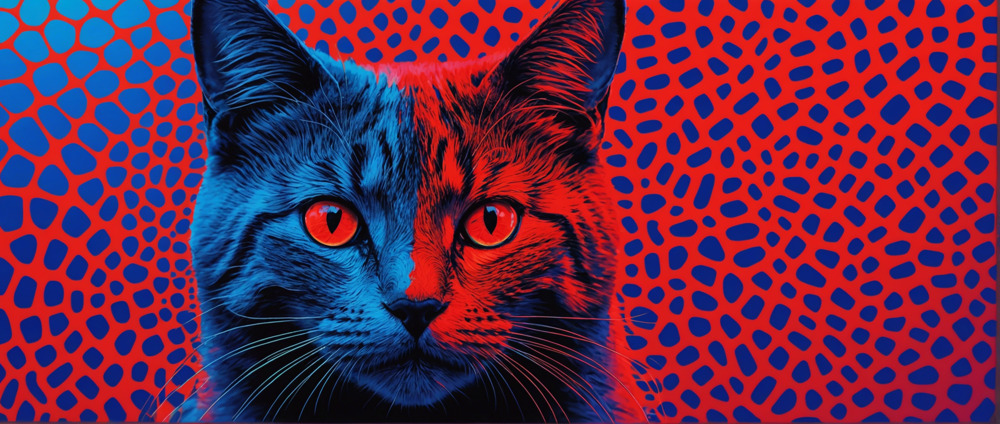

In [ ]:
#@title Stable Image Core

prompt = "op art cat illusion red blue chromostereopsis maximum saturation" #@param {type:"string"}
negative_prompt = "" #@param {type:"string"}
aspect_ratio = "21:9" #@param ["21:9", "16:9", "3:2", "5:4", "1:1", "4:5", "2:3", "9:16", "9:21"]
seed = 0 #@param {type:"integer"}
output_format = "png" #@param ["webp", "jpeg", "png"]

host = f"https://api.stability.ai/v2beta/stable-image/generate/core"

params = {
    "prompt" : prompt,
    "negative_prompt" : negative_prompt,
    "aspect_ratio" : aspect_ratio,
    "seed" : seed,
    "output_format": output_format
}

response = send_generation_request(
    host,
    params
)

# Decode response
output_image = response.content
finish_reason = response.headers.get("finish-reason")
seed = response.headers.get("seed")

# Check for NSFW classification
if finish_reason == 'CONTENT_FILTERED':
    raise Warning("Generation failed NSFW classifier")

# Save and display result
generated = f"generated_{seed}.{output_format}"
with open(generated, "wb") as f:
    f.write(output_image)
print(f"Saved image {generated}")

output.no_vertical_scroll()
print("Result image:")
IPython.display.display(Image.open(generated))


Sending REST request to https://api.stability.ai/v2beta/stable-image/generate/sd3...
Saved image generated_1687099494.jpeg


<IPython.core.display.Javascript object>

Result image:


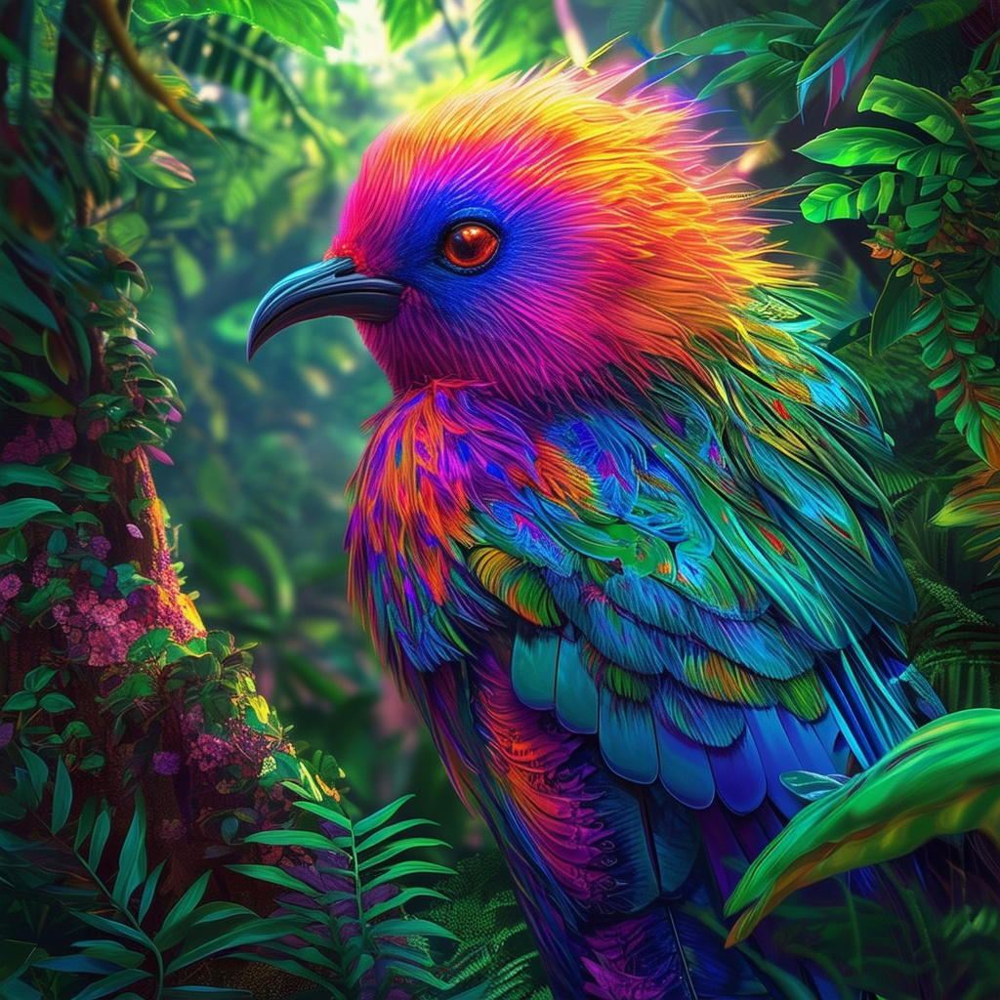

In [12]:
#@title SD3

prompt = "This dreamlike digital art captures a vibrant, kaleidoscopic bird in a lush rainforest" #@param {type:"string"}
negative_prompt = "" #@param {type:"string"}
aspect_ratio = "1:1" #@param ["21:9", "16:9", "3:2", "5:4", "1:1", "4:5", "2:3", "9:16", "9:21"]
seed = 0 #@param {type:"integer"}
output_format = "jpeg" #@param ["jpeg", "png"]
model = "sd3" #@param ["sd3", "sd3-turbo"]

host = f"https://api.stability.ai/v2beta/stable-image/generate/sd3"

params = {
    "prompt" : prompt,
    "negative_prompt" : negative_prompt if model=="sd3" else "",
    "aspect_ratio" : aspect_ratio,
    "seed" : seed,
    "output_format" : output_format,
    "model" : model,
    "mode" : "text-to-image"
}

response = send_generation_request(
    host,
    params
)

# Decode response
output_image = response.content
finish_reason = response.headers.get("finish-reason")
seed = response.headers.get("seed")

# Check for NSFW classification
if finish_reason == 'CONTENT_FILTERED':
    raise Warning("Generation failed NSFW classifier")

# Save and display result
generated = f"generated_{seed}.{output_format}"
with open(generated, "wb") as f:
    f.write(output_image)
print(f"Saved image {generated}")

output.no_vertical_scroll()
print("Result image:")
IPython.display.display(Image.open(generated))

# Upscale
Stable Image Upscaling services include one offering currently in production.

Creative Upscaler: This service will transform a low quality, low resolution image into a stunning work of art with intricate details at 9mp resolution - regardless of the input resolution. Provide an input image of poor quality and add a `prompt` that describes the desired output. High `creativity` (up to 0.35) will yield dramatic changes to the image.
This service will use 25 credits.

See https://platform.stability.ai/docs/api-reference#tag/Upscale

Try the service out in the section below. Check back in for regular updates.


Feedback welcome.


Sending REST request to https://api.stability.ai/v2beta/stable-image/upscale/creative...
Saved image upscaled_bird_1465879083.webp
Original image:


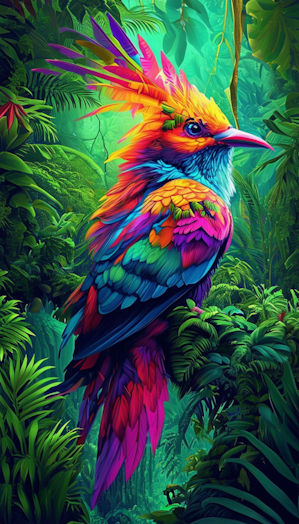

Result image:


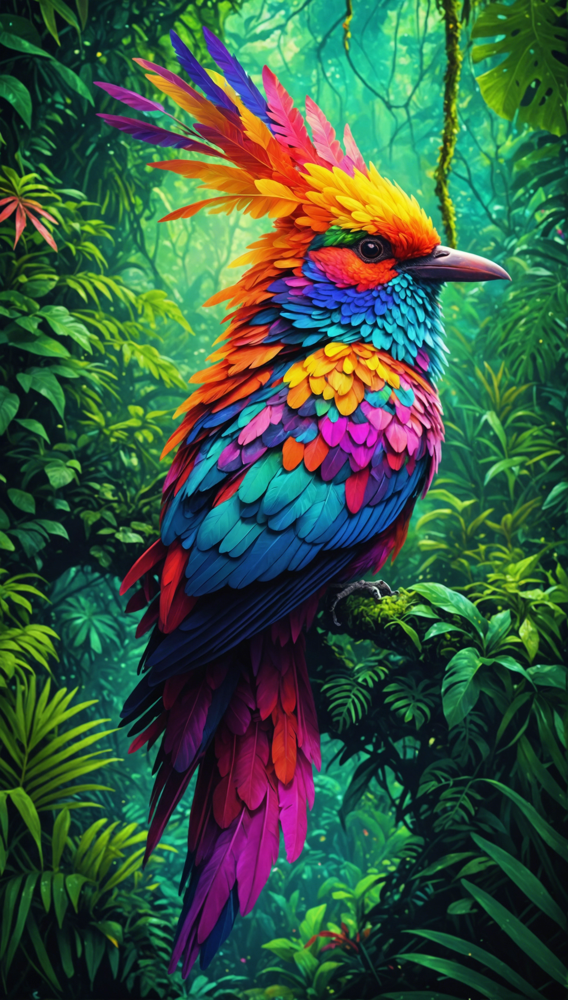

In [ ]:
#@title Creative Upscaler

#@markdown - Drag and drop image to file folder on left
#@markdown - Right click it and choose Copy path
#@markdown - Paste that path into init_image field below
#@markdown <br><br>

init_image = "/content/bird.png" #@param {type:"string"}
prompt = "This dreamlike digital art captures a vibrant, kaleidoscopic bird in a lush rainforest" #@param {type:"string"}
negative_prompt = "" #@param {type:"string"}
seed = 0 #@param {type:"integer"}
creativity = 0.30 #@param {type:"number"}
output_format = "webp" #@param ["webp", "jpeg", "png"]

host = f"https://api.stability.ai/v2beta/stable-image/upscale/creative"

params = {
    "prompt" : prompt,
    "negative_prompt" : negative_prompt,
    "seed" : seed,
    "creativity" : creativity,
    "init_image" : init_image,
    "output_format": output_format
}

response = send_async_generation_request(
    host,
    params
)

# Decode response
output_image = response.content
finish_reason = response.headers.get("finish-reason")
seed = response.headers.get("seed")

# Check for NSFW classification
if finish_reason == 'CONTENT_FILTERED':
    raise Warning("Generation failed NSFW classifier")

# Save and display result
filename, _ = os.path.splitext(os.path.basename(init_image))
upscaled = f"upscaled_{filename}_{seed}.{output_format}"
with open(upscaled, "wb") as f:
    f.write(output_image)
print(f"Saved image {upscaled}")

print("Original image:")
IPython.display.display(Image.open(init_image))
print("Result image:")
IPython.display.display(Image.open(upscaled))

# Edit

Stable Image editing services include four offerings currently in production:

- Inpaint: where you specify a `mask` (or use the alpha channel of the `image` parameter). The `prompt` is what will be added to the image in the masked area. Regardless of input resolution, the output will be provided at 4mp. This service will use 3 credits.
- Search-and-Replace: where you specify what you want to replace in the input image via `search_prompt`. The `prompt` is what will be added to the image in place of the object from the search_prompt. Regardless of input resolution, the output will be provided at 4mp. This service will use 4 credits.
- Outpaint: Extend an image in any direction. This service will use 4 credits.
- Remove Background: Removes the background from an image. This service will use 2 credits.

See https://platform.stability.ai/docs/api-reference#tag/Edit

Try these services out in the sections below. Check back in for regular updates.

Feedback welcome.

Sending REST request to https://api.stability.ai/v2beta/stable-image/edit/inpaint...
Saved image edited_tux_496884147.webp


<IPython.core.display.Javascript object>

Original image:


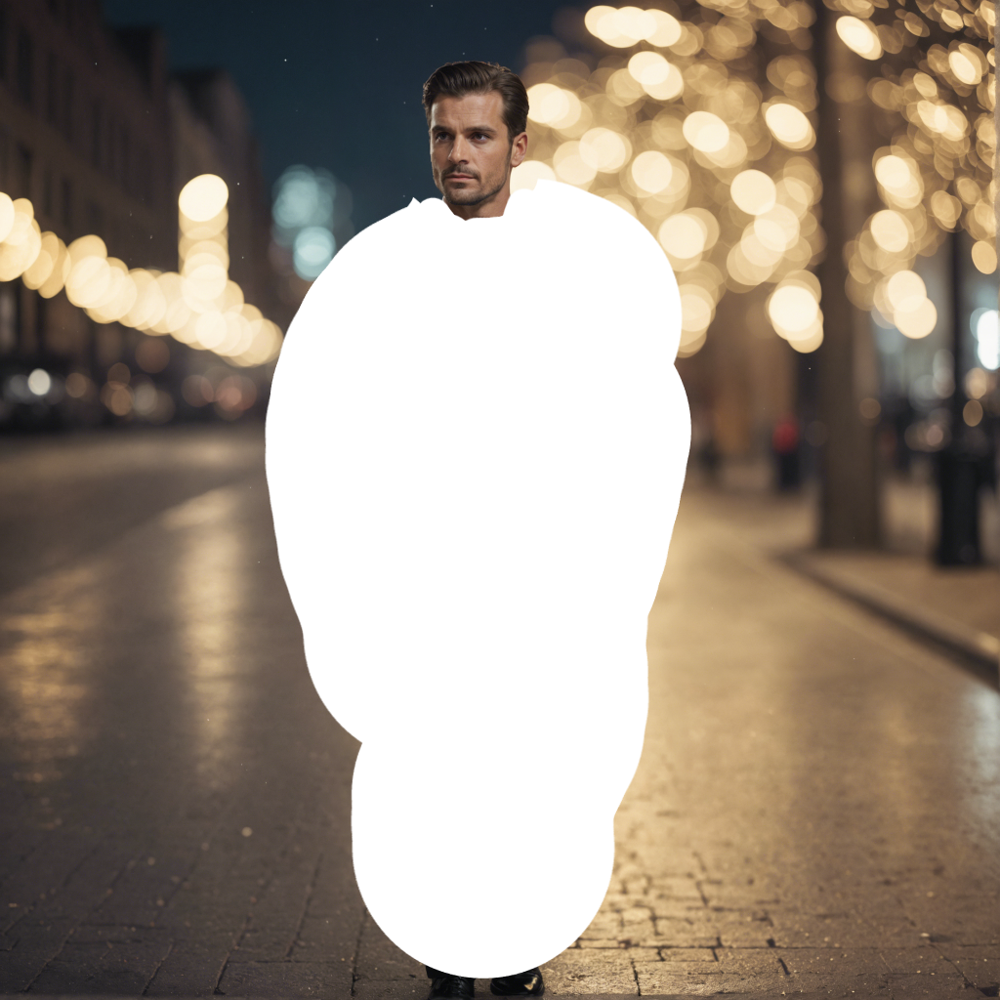

Result image:


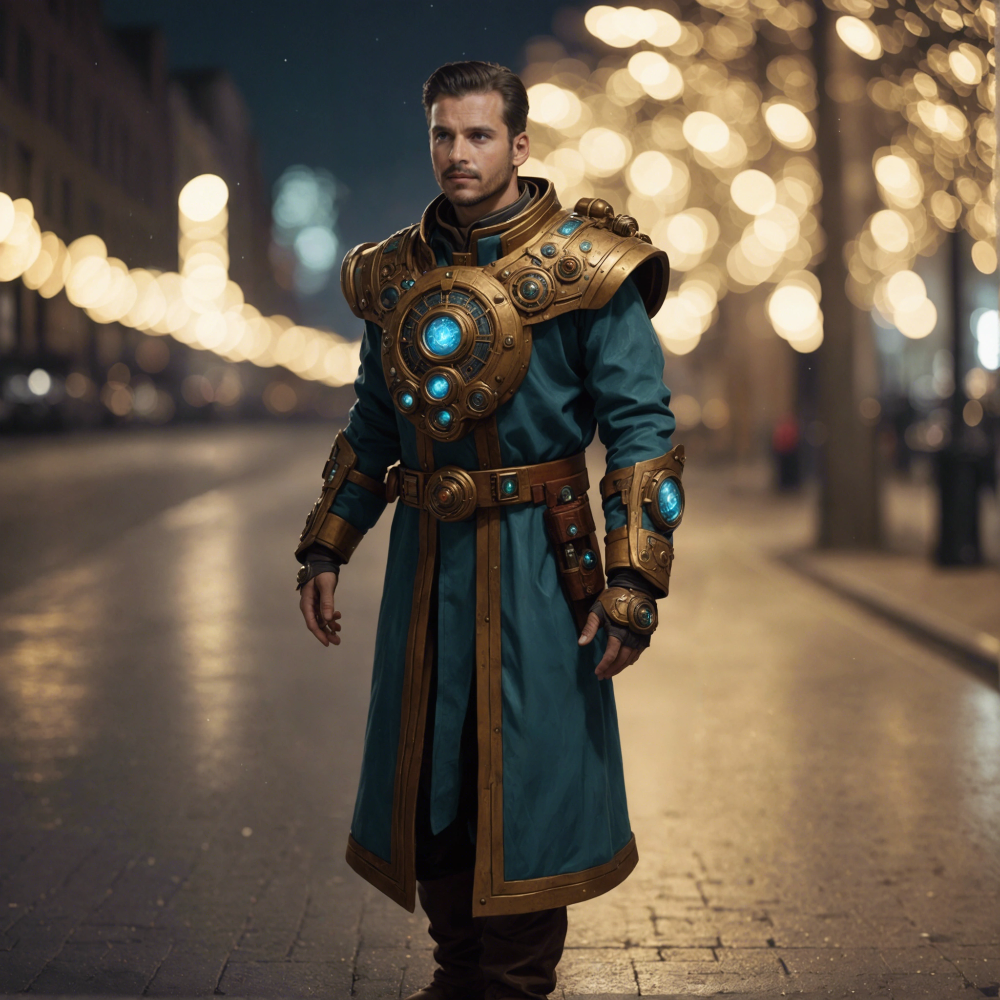

In [ ]:
#@title Inpaint

#@markdown - Drag and drop image to file folder on left
#@markdown - Right click it and choose Copy path
#@markdown - Paste that path into image field below
#@markdown <br><br>

image = "/content/tux.png" #@param {type:"string"}
mask = "" #@param {type:"string"}
prompt = "artificer of time and space" #@param {type:"string"}
negative_prompt = "" #@param {type:"string"}
seed = 0 #@param {type:"integer"}
output_format = "webp" #@param ["webp", "jpeg", "png"]

host = f"https://api.stability.ai/v2beta/stable-image/edit/inpaint"

params = {
    "image" : image,
    "mask" : mask,
    "negative_prompt" : negative_prompt,
    "seed" : seed,
    "mode": "mask",
    "output_format": output_format,
    "prompt" : prompt
}

response = send_generation_request(
    host,
    params
)

# Decode response
output_image = response.content
finish_reason = response.headers.get("finish-reason")
seed = response.headers.get("seed")

# Check for NSFW classification
if finish_reason == 'CONTENT_FILTERED':
    raise Warning("Generation failed NSFW classifier")

# Save and display result
filename, _ = os.path.splitext(os.path.basename(image))
edited = f"edited_{filename}_{seed}.{output_format}"
with open(edited, "wb") as f:
    f.write(output_image)
print(f"Saved image {edited}")

output.no_vertical_scroll()
print("Original image:")
IPython.display.display(Image.open(image))
print("Result image:")
IPython.display.display(Image.open(edited))

Sending REST request to https://api.stability.ai/v2beta/stable-image/edit/outpaint...
Saved image edited_chicken_230990982.webp


<IPython.core.display.Javascript object>

Original image:


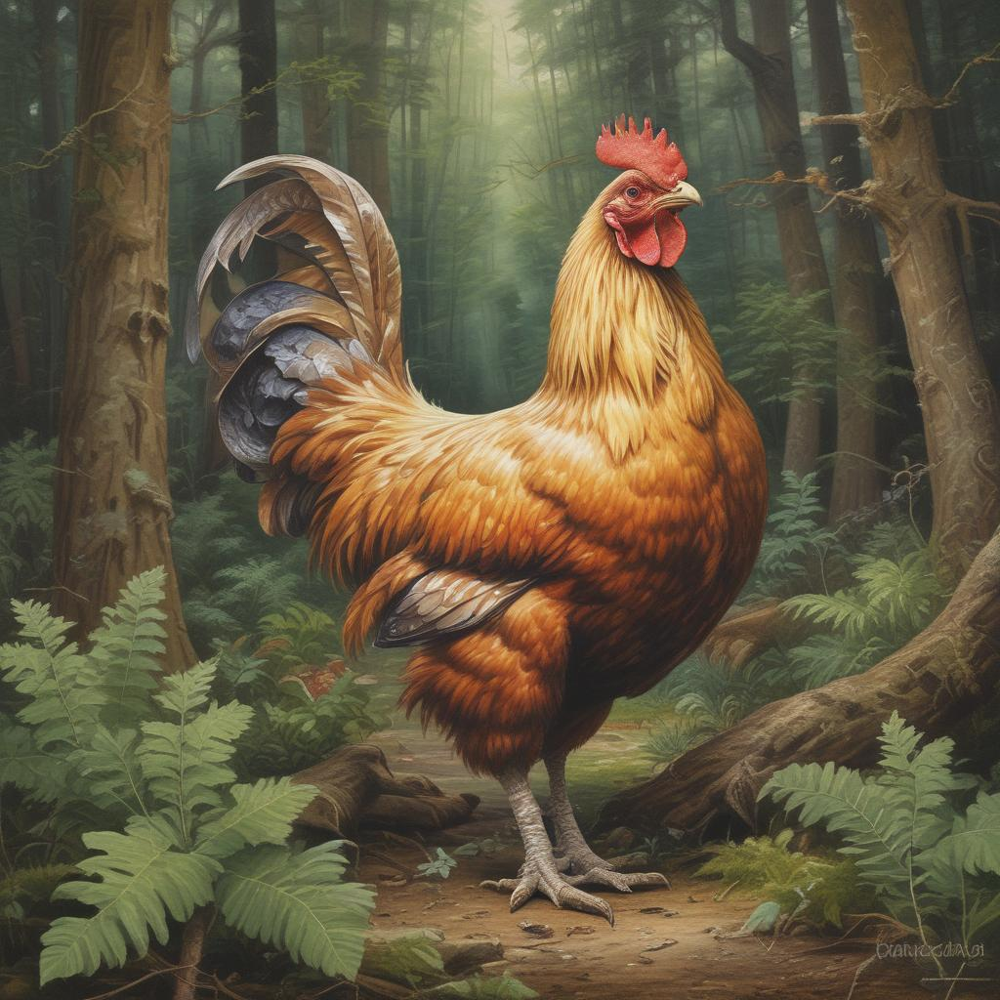

Result image:


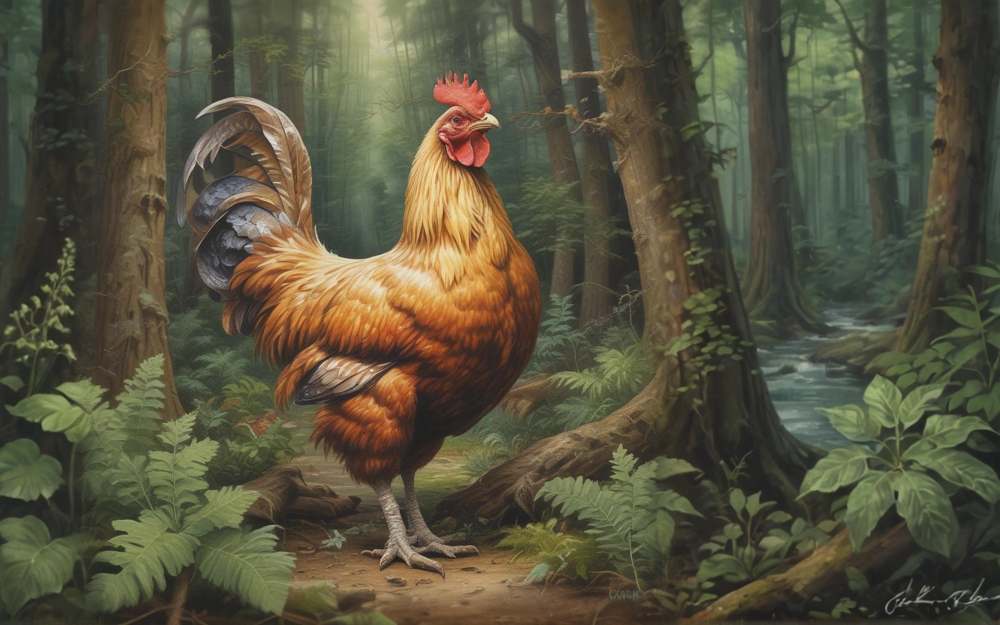

In [ ]:
#@title Outpaint

#@markdown - Drag and drop image to file folder on left
#@markdown - Right click it and choose Copy path
#@markdown - Paste that path into image field below
#@markdown <br><br>

image = "/content/chicken.png" #@param {type:"string"}
left = 100 #@param {type:"number"}
right = 512 #@param {type:"number"}
top = 0 #@param {type:"number"}
bottom = 0 #@param {type:"number"}
prompt = "" #@param {type:"string"}
seed = 0 #@param {type:"integer"}
output_format = "webp" #@param ["webp", "jpeg", "png"]

host = f"https://api.stability.ai/v2beta/stable-image/edit/outpaint"

params = {
    "image" : image,
    "left" : left,
    "right" : right,
    "top" : top,
    "bottom" : bottom,
    "prompt" : prompt,
    "seed" : seed,
    "output_format": output_format
}

response = send_generation_request(
    host,
    params
)

# Decode response
output_image = response.content
finish_reason = response.headers.get("finish-reason")
seed = response.headers.get("seed")

# Check for NSFW classification
if finish_reason == 'CONTENT_FILTERED':
    raise Warning("Generation failed NSFW classifier")

# Save and display result
filename, _ = os.path.splitext(os.path.basename(image))
edited = f"edited_{filename}_{seed}.{output_format}"
with open(edited, "wb") as f:
    f.write(output_image)
print(f"Saved image {edited}")

output.no_vertical_scroll()
print("Original image:")
IPython.display.display(Image.open(image))
print("Result image:")
IPython.display.display(Image.open(edited))

Sending REST request to https://api.stability.ai/v2beta/stable-image/edit/search-and-replace...
Saved image edited_chicken_4076443773.webp


<IPython.core.display.Javascript object>

Original image:


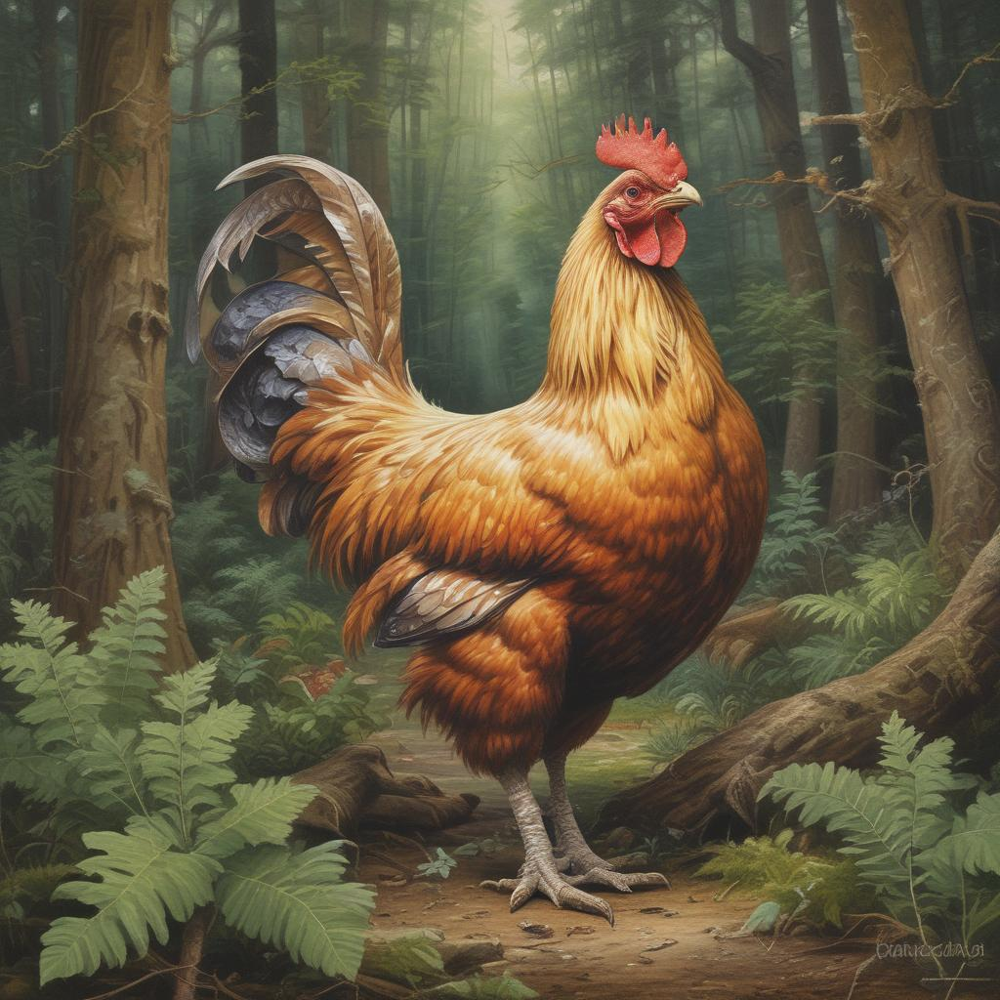

Result image:


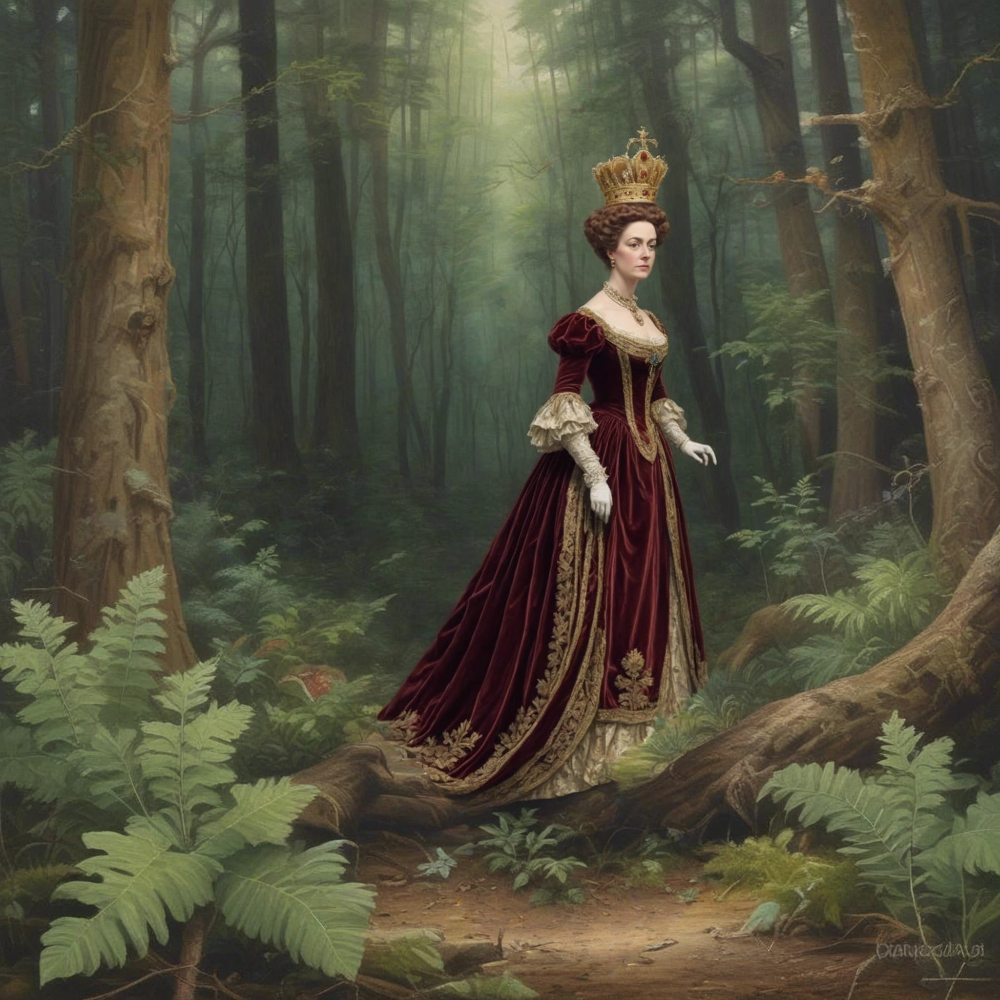

In [ ]:
#@title Search-and-Replace

#@markdown - Drag and drop image to file folder on left
#@markdown - Right click it and choose Copy path
#@markdown - Paste that path into image field below
#@markdown <br><br>

image = "/content/chicken.png" #@param {type:"string"}
prompt = "a victorian queen standing in the forest, looking at the viewer" #@param {type:"string"}
search_prompt = "chicken" #@param {type:"string"}
negative_prompt = "" #@param {type:"string"}
seed = 0 #@param {type:"integer"}
output_format = "webp" #@param ["webp", "jpeg", "png"]

host = f"https://api.stability.ai/v2beta/stable-image/edit/search-and-replace"

params = {
    "image" : image,
    "seed" : seed,
    "mode": "search",
    "output_format": output_format,
    "prompt" : prompt,
    "negative_prompt" : negative_prompt,
    "search_prompt": search_prompt,
}

response = send_generation_request(
    host,
    params
)

# Decode response
output_image = response.content
finish_reason = response.headers.get("finish-reason")
seed = response.headers.get("seed")

# Check for NSFW classification
if finish_reason == 'CONTENT_FILTERED':
    raise Warning("Generation failed NSFW classifier")

# Save and display result
filename, _ = os.path.splitext(os.path.basename(image))
edited = f"edited_{filename}_{seed}.{output_format}"
with open(edited, "wb") as f:
    f.write(output_image)
print(f"Saved image {edited}")

output.no_vertical_scroll()
print("Original image:")
IPython.display.display(Image.open(image))
print("Result image:")
IPython.display.display(Image.open(edited))

Sending REST request to https://api.stability.ai/v2beta/stable-image/edit/remove-background...
Saved image edited_img_2152356394.webp


<IPython.core.display.Javascript object>

Original image:


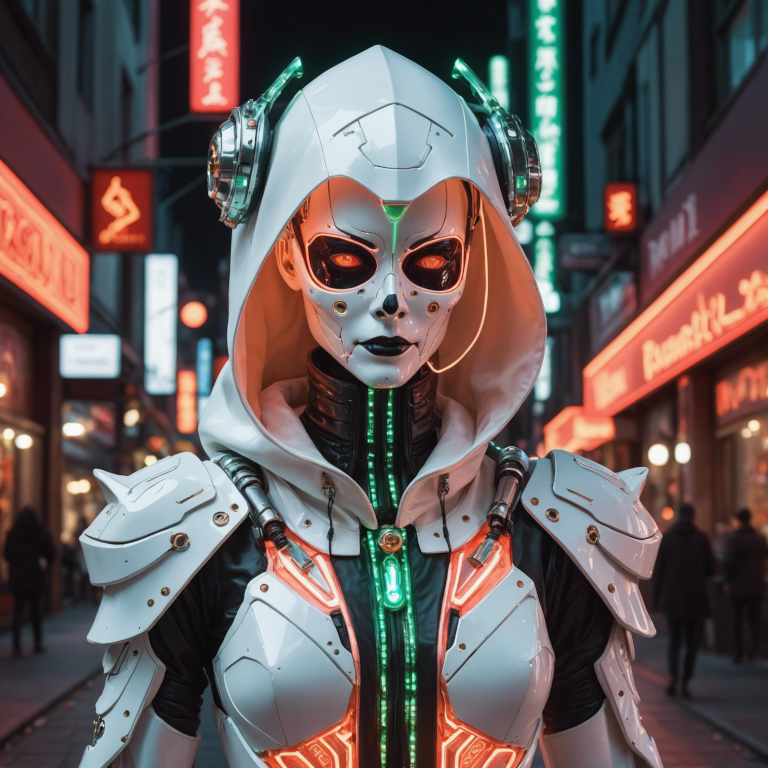

Result image:


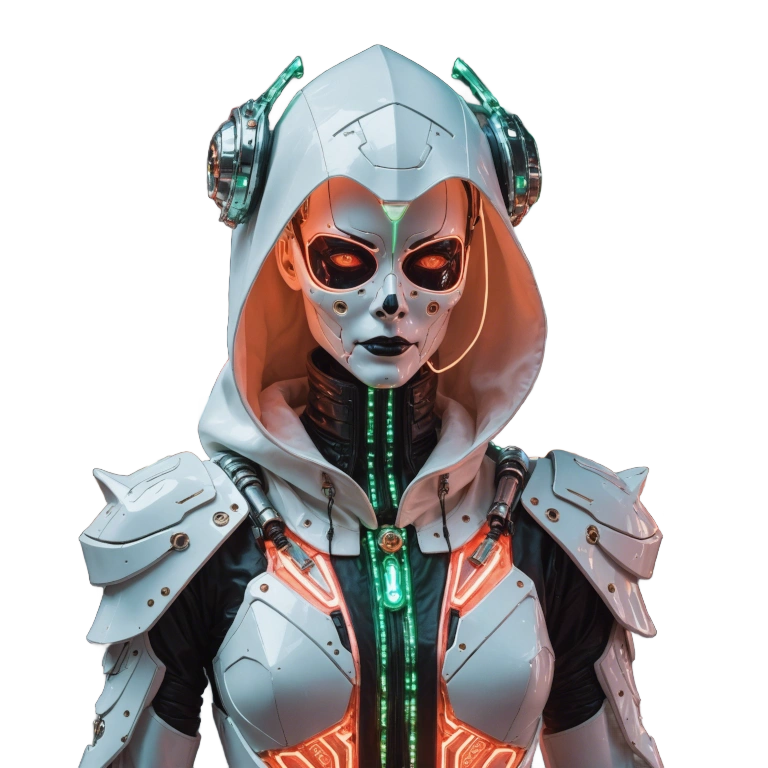

In [ ]:
#@title Remove Background

#@markdown - Drag and drop image to file folder on left
#@markdown - Right click it and choose Copy path
#@markdown - Paste that path into image field below
#@markdown <br><br>

image = "/content/img.png" #@param {type:"string"}
output_format = "webp" #@param ["webp", "jpeg", "png"]

host = f"https://api.stability.ai/v2beta/stable-image/edit/remove-background"

params = {
    "image" : image,
    "output_format": output_format
}

response = send_generation_request(
    host,
    params
)

# Decode response
output_image = response.content
finish_reason = response.headers.get("finish-reason")
seed = response.headers.get("seed")

# Check for NSFW classification
if finish_reason == 'CONTENT_FILTERED':
    raise Warning("Generation failed NSFW classifier")

# Save and display result
filename, _ = os.path.splitext(os.path.basename(image))
edited = f"edited_{filename}_{seed}.{output_format}"
with open(edited, "wb") as f:
    f.write(output_image)
print(f"Saved image {edited}")

output.no_vertical_scroll()
print("Original image:")
IPython.display.display(Image.open(image))
print("Result image:")
IPython.display.display(Image.open(edited))